<a href="https://colab.research.google.com/github/Primary43/TripDuration-Prediction-based-on-Locational-cluster/blob/main/03_FeatureEngineering_Clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#! pip install pyspark --quiet
! pip install seaborn-qqplot --quiet

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pyspark.pandas as ps
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

/usr/local/lib/python3.10/dist-packages/pyspark/pandas/__init__.py:50: UserWarning: 'PYARROW_IGNORE_TIMEZONE' environment variable was not set. It is required to set this environment variable to '1' in both driver and executor sides if you use pyarrow>=2.0.0. pandas-on-Spark will set it for you but it does not work if there is a Spark context already launched.
  warnings.warn(


## 1.0 Load Preprocess Features from Previous Parts
* We extracted temporal features such as month, day of the week, hour bins from pickup_datetime
* Trip_duration_min and distance_km were calculated
* Catagorical features were encoded to numeric

In [ ]:
sdf = ps.read_parquet('/content/drive/MyDrive/Colab Notebooks/taxi_duration/data/processed_data.parquet')
sdf = sdf.set_index('id')
print(sdf.info())
display(sdf.head())

# transform hour into bin hour--------------------------------------
bins = [-1, 4, 8, 12, 17, 21, 23]
labels = ['0.00-4.59', '5.00-8.59', '9.00-12.58', '13.00-17.59', '18.00-21.59', '22.00-23.59']
# Function to assign label based on the hour
def assign_label(hour):
    for i in range(len(bins) - 1):
        if bins[i] < hour <= bins[i + 1]:
            return labels[i]
    return None

sdf['hour_bin'] = sdf['hour_of_day'].apply(assign_label)
sdf = sdf.drop(columns=['day_of_year','hour_of_day'])

# Convert catagorical features to numeric --------------------------------------
#Convert to numeric for binary feature
sdf = ps.get_dummies(data=sdf, columns=['vendor_id','store_and_fwd_flag', 'hour_bin', 'day_of_week','month'],drop_first=True)
print(sdf.info())
display(sdf.head())

/usr/local/lib/python3.10/dist-packages/pyspark/pandas/utils.py:1016: PandasAPIOnSparkAdviceWarning: If `index_col` is not specified for `read_parquet`, the default index is attached which can cause additional overhead.
  warnings.warn(message, PandasAPIOnSparkAdviceWarning)


<class 'pyspark.pandas.frame.DataFrame'>
Int64Index: 729322 entries, 1 to 4000000
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   vendor_id           729322 non-null  object 
 1   passenger_count     729322 non-null  int64  
 2   store_and_fwd_flag  729322 non-null  object 
 3   trip_duration_min   729322 non-null  int64  
 4   day_of_year         729322 non-null  int64  
 5   week_of_year        729322 non-null  int64  
 6   month               729322 non-null  int64  
 7   day_of_week         729322 non-null  int64  
 8   hour_of_day         729322 non-null  int64  
 9   pickup_longitude    729322 non-null  float64
 10  pickup_latitude     729322 non-null  float64
 11  dropoff_longitude   729322 non-null  float64
 12  dropoff_latitude    729322 non-null  float64
 13  distance_km         729322 non-null  float64
dtypes: float64(5), int64(7), object(2)None


,vendor_id,passenger_count,store_and_fwd_flag,trip_duration_min,day_of_year,week_of_year,month,day_of_week,hour_of_day,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,distance_km
id,,,,,,,,,,,,,,
1,2,1,N,18,166,24,6,1,10,-74.013924,40.713924,-73.971649,40.746407,6.688752
3,2,5,N,17,76,11,3,2,10,-73.990753,40.754761,-74.007118,40.741531,2.658671
5,2,1,N,6,116,17,4,0,9,-73.953110,40.798580,-73.968178,40.800270,1.695537
8,1,1,N,5,167,24,6,2,9,-74.009628,40.724762,-74.015869,40.715485,1.524838
16,1,1,N,6,89,13,3,1,16,-73.960320,40.770321,-73.946220,40.772736,1.608840


<class 'pyspark.pandas.frame.DataFrame'>
Int64Index: 729322 entries, 1 to 4000000
Data columns (total 26 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   passenger_count       729322 non-null  int64  
 1   trip_duration_min     729322 non-null  int64  
 2   week_of_year          729322 non-null  int64  
 3   pickup_longitude      729322 non-null  float64
 4   pickup_latitude       729322 non-null  float64
 5   dropoff_longitude     729322 non-null  float64
 6   dropoff_latitude      729322 non-null  float64
 7   distance_km           729322 non-null  float64
 8   vendor_id_2           729322 non-null  int8   
 9   store_and_fwd_flag_Y  729322 non-null  int8   
 10  hour_bin_13.00-17.59  729322 non-null  int8   
 11  hour_bin_18.00-21.59  729322 non-null  int8   
 12  hour_bin_22.00-23.59  729322 non-null  int8   
 13  hour_bin_5.00-8.59    729322 non-null  int8   
 14  hour_bin_9.00-12.58   729322 non-null  int8   
 

,passenger_count,trip_duration_min,week_of_year,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,distance_km,vendor_id_2,store_and_fwd_flag_Y,hour_bin_13.00-17.59,hour_bin_18.00-21.59,hour_bin_22.00-23.59,hour_bin_5.00-8.59,hour_bin_9.00-12.58,day_of_week_1,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6
id,,,,,,,,,,,,,,,,,,,,,,,,,,
1,1,18,24,-74.013924,40.713924,-73.971649,40.746407,6.688752,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1
3,5,17,11,-73.990753,40.754761,-74.007118,40.741531,2.658671,1,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0
5,1,6,17,-73.953110,40.798580,-73.968178,40.800270,1.695537,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0
8,1,5,24,-74.009628,40.724762,-74.015869,40.715485,1.524838,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1
16,1,6,13,-73.960320,40.770321,-73.946220,40.772736,1.608840,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0


## 2.1 Inspeact Feature Transformation
* Filter extreme outlier (based on insight from EDA)before transforming the data can make the transformation more effective.
* Apply log transformation to reduce skewness in variables we found from EDA.
* Apply feature scaling before feeding regression model

In [ ]:
# numerical univariate fuction
def UVA_numeric(data, var_group):
  '''
  Univariate_Analysis_numeric
  takes a group of variables (INTEGER and FLOAT) and plot/print all the descriptives and properties along with KDE.
  '''
  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)

  #looping for each variable
  for j,i in enumerate(var_group):
    # calculating descriptives of variable
    mini = data[i].min()
    maxi = data[i].max()
    ran = data[i].max()-data[i].min()
    mean = data[i].mean()
    median = data[i].median()
    st_dev = data[i].std()
    skew = data[i].skew()
    kurt = data[i].kurtosis()
    # calculating points of standard deviation
    points = mean-st_dev, mean+st_dev
    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.kdeplot(data[i], fill=True)
    sns.lineplot(x=points, y=[0,0], color = 'black', label = "std_dev")
    sns.scatterplot(x=[mini,maxi], y=[0,0], color = 'orange', label = "min/max")
    sns.scatterplot(x=[mean], y=[0], color = 'red', label = "mean")
    sns.scatterplot(x=[median], y=[0], color = 'blue', label = "median")
    plt.xlabel('{}'.format(i), fontsize = 20)
    plt.ylabel('density')
    plt.title('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurt,2),
                                                                                                   round(skew,2),
                                                                                                   (round(mini,2),round(maxi,2),round(ran,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)))

def UVA_outlier(data, var_group):
  '''
  Univariate_Analysis_outlier:
  takes a group of variables (INTEGER and FLOAT) and plot/print boplot and descriptives\n
  '''

  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)

  #looping for each variable
  for j,i in enumerate(var_group):

    # calculating descriptives of variable
    quant25 = data[i].quantile(0.25)
    quant75 = data[i].quantile(0.75)
    IQR = quant75 - quant25
    med = data[i].median()
    whis_low = quant25-(1.5*IQR)
    whis_high = quant75+(1.5*IQR)

    # Calculating Number of Outliers
    outlier_high = len(data[i][data[i]>whis_high])
    outlier_low = len(data[i][data[i]<whis_low])

    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.boxplot(data=data[i], orient="v")
    plt.ylabel('{}'.format(i))
    plt.title('With Outliers\nIQR = {}; Median = {} \n 1st,3rd  quartile = {};\n Outlier (low/high) = {} \n'.format(
                                                                                                   round(IQR,2),
                                                                                                   round(med,2),
                                                                                                   (round(quant25,2),round(quant75,2)),
                                                                                                   (outlier_low,outlier_high)
                                                                                                   ))


/usr/local/lib/python3.10/dist-packages/pyspark/pandas/utils.py:1016: PandasAPIOnSparkAdviceWarning: `to_pandas` loads all data into the driver's memory. It should only be used if the resulting pandas DataFrame is expected to be small.
  warnings.warn(message, PandasAPIOnSparkAdviceWarning)


Before filter:------------------


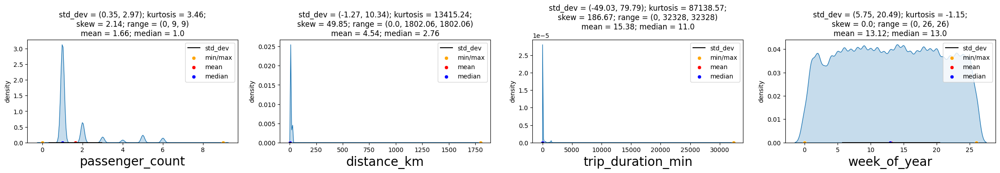

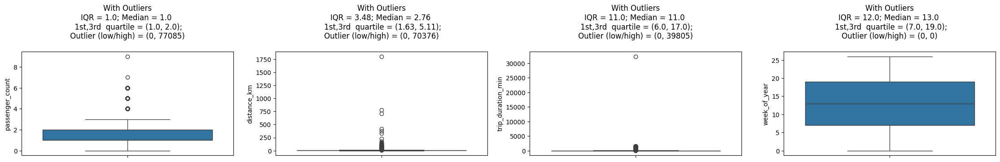

<class 'pyspark.pandas.frame.DataFrame'>
Int64Index: 727848 entries, 1 to 4000000
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   passenger_count       727848 non-null  int64  
 1   trip_duration_min     727848 non-null  int64  
 2   week_of_year          727848 non-null  int64  
 3   distance_km           727848 non-null  float64
 4   vendor_id_2           727848 non-null  int8   
 5   store_and_fwd_flag_Y  727848 non-null  int8   
 6   hour_bin_13.00-17.59  727848 non-null  int8   
 7   hour_bin_18.00-21.59  727848 non-null  int8   
 8   hour_bin_22.00-23.59  727848 non-null  int8   
 9   hour_bin_5.00-8.59    727848 non-null  int8   
 10  hour_bin_9.00-12.58   727848 non-null  int8   
 11  day_of_week_1         727848 non-null  int8   
 12  day_of_week_2         727848 non-null  int8   
 13  day_of_week_3         727848 non-null  int8   
 14  day_of_week_4         727848 non-null  int8   
 

,passenger_count,trip_duration_min,week_of_year,distance_km,vendor_id_2,store_and_fwd_flag_Y,hour_bin_13.00-17.59,hour_bin_18.00-21.59,hour_bin_22.00-23.59,hour_bin_5.00-8.59,hour_bin_9.00-12.58,day_of_week_1,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6
id,,,,,,,,,,,,,,,,,,,,,,
1,1,18,24,6.688752,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1
3,5,17,11,2.658671,1,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0
5,1,6,17,1.695537,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0
8,1,5,24,1.524838,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1
16,1,6,13,1.608840,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0


/usr/local/lib/python3.10/dist-packages/pyspark/pandas/utils.py:1016: PandasAPIOnSparkAdviceWarning: `to_pandas` loads all data into the driver's memory. It should only be used if the resulting pandas DataFrame is expected to be small.
  warnings.warn(message, PandasAPIOnSparkAdviceWarning)


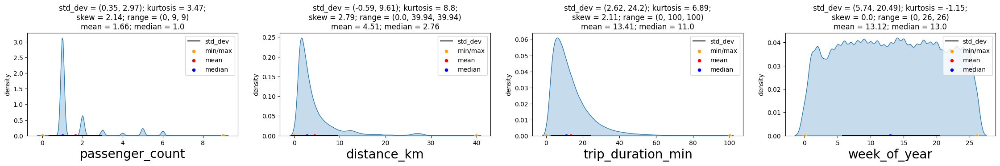

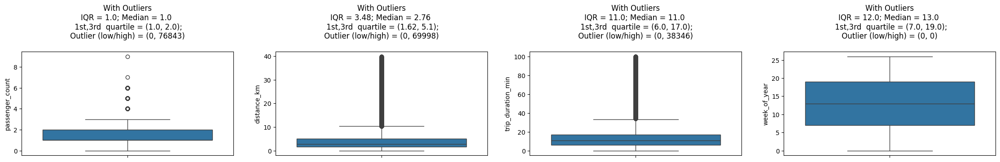

In [ ]:
# Inspect and remove extreme outlier --------------------------------------
df = sdf.to_pandas()
num_cols = ['passenger_count', 'distance_km','trip_duration_min', 'week_of_year']
print('Before filter:------------------')
UVA_numeric(df, num_cols)
UVA_outlier(df, num_cols)
plt.show()

filtered_sdf = sdf[(sdf['distance_km'] <= 40) & (sdf['trip_duration_min'] <= 100)]
geo_cols = ['pickup_longitude', 'pickup_latitude', 'dropoff_longitude','dropoff_latitude']
sdf_geo = filtered_sdf.copy()
sdf_geo = sdf_geo[geo_cols]
filtered_sdf = filtered_sdf.drop(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'], axis=1)

print(filtered_sdf.info())
display(filtered_sdf.head())
filtered_df = filtered_sdf.to_pandas()
UVA_numeric(filtered_df, num_cols)
UVA_outlier(filtered_df, num_cols)


Apply log transform:------------------


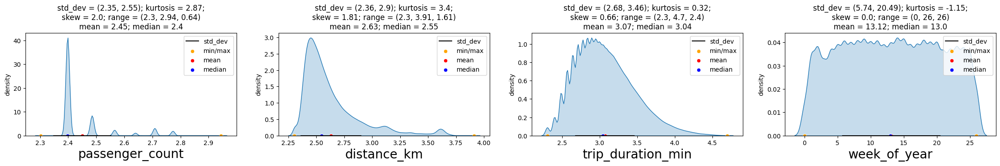


Apply StandardScaler:------------------


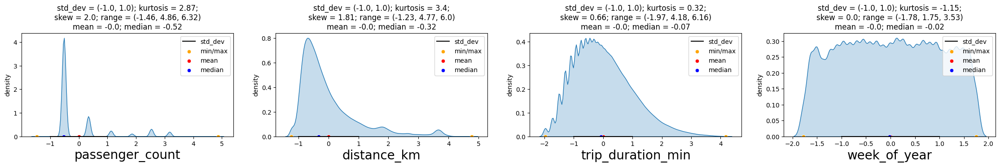

In [ ]:
# Inspeact the result after applying log
log_cols = num_cols[:-1]  # Exclude 'week_of_year' for log transform as it is normal distributed already
log_df = filtered_df.copy()
for col in log_cols:
    log_df[col] = np.log(log_df[col] + 10)

print('\nApply log transform:------------------')
UVA_numeric(log_df, num_cols)
plt.show()

# Inspeact the result after applying scaling
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
scaled_data = std.fit_transform(log_df[num_cols])
scaled_df = pd.DataFrame(scaled_data, columns=num_cols)
print('\nApply StandardScaler:------------------')
UVA_numeric(scaled_df, num_cols)

## 2.2 Transformation Pipeline for Training and Testing set



In [ ]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

# Create X and Y for training and testing set
Y = filtered_df.trip_duration_min
X = filtered_df.drop(['trip_duration_min'],axis = 1)

# Define X_log features
log_X_feature = ['passenger_count', 'distance_km']

def log_transform(x):
    return np.log(x + 10)

# Apply the log transformation to the specified features
for feature in log_X_feature:
    X_log = X.copy()
    X_log[feature] = log_transform(X_log[feature])

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_log, Y, test_size=0.2, random_state=42)

# Apply log transformation to the target variable
y_train_log = np.log(y_train + 10)
y_test_log = np.log(y_test + 10)


# Define the numerical and categorical features
numeric_X_features = ['passenger_count', 'distance_km', 'week_of_year']
categorical_features = [col for col in X.columns if col not in numeric_X_features]

# Create a transformer for numerical features
numeric_transformer = Pipeline(steps=[
    ('scale', StandardScaler())
])

# Combine the transformed numerical data back with categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_X_features),
        ('cat', 'passthrough', categorical_features)
    ])

# Apply the transformations to the training data and the test data
X_train_transformed = preprocessor.fit_transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

X_train_df = pd.DataFrame(X_train_transformed, columns=numeric_X_features + categorical_features, index=X_train.index)
X_test_df = pd.DataFrame(X_test_transformed, columns=numeric_X_features + categorical_features, index=X_test.index)


print(X_train.shape)
print(X_test.shape)
print(y_train_log.shape)
print(y_test_log.shape)

print(X_train_transformed)
print(X_test_transformed)

display(X_train_df.head())
display(X_test_df.head())
print(y_train_log)
print(y_test_log)

(582278, 21)
(145570, 21)
(582278,)
(145570,)
[[-0.50437668 -0.72661166  0.66328154 ...  0.          1.
   0.        ]
 [-0.50437668 -0.42231573 -1.10029411 ...  0.          0.
   0.        ]
 [-0.50437668 -0.72622247 -0.01501679 ...  1.          0.
   0.        ]
 ...
 [ 0.25718781  0.25075116 -0.55765545 ...  0.          0.
   0.        ]
 [-0.50437668 -0.86637956 -0.82897478 ...  0.          0.
   0.        ]
 [-0.50437668  0.75546699  1.07026054 ...  0.          1.
   0.        ]]
[[-0.50437668 -0.87532651 -1.23595377 ...  0.          0.
   0.        ]
 [-0.50437668  3.70206067  1.74855886 ...  0.          0.
   1.        ]
 [-0.50437668  0.15445792 -0.69331511 ...  0.          0.
   0.        ]
 ...
 [-0.50437668 -0.8109381  -1.10029411 ...  0.          0.
   0.        ]
 [-0.50437668 -0.50385086 -1.10029411 ...  0.          0.
   0.        ]
 [ 0.25718781  0.20737258 -0.55765545 ...  0.          0.
   0.        ]]


,passenger_count,distance_km,week_of_year,vendor_id_2,store_and_fwd_flag_Y,hour_bin_13.00-17.59,hour_bin_18.00-21.59,hour_bin_22.00-23.59,hour_bin_5.00-8.59,hour_bin_9.00-12.58,...,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6
id,,,,,,,,,,,,,,,,,,,,,
2521942,-0.504377,-0.726612,0.663282,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
52820,-0.504377,-0.422316,-1.100294,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
104544,-0.504377,-0.726222,-0.015017,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2471743,0.257188,-0.191662,0.663282,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1256624,0.257188,0.143746,1.070261,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


,passenger_count,distance_km,week_of_year,vendor_id_2,store_and_fwd_flag_Y,hour_bin_13.00-17.59,hour_bin_18.00-21.59,hour_bin_22.00-23.59,hour_bin_5.00-8.59,hour_bin_9.00-12.58,...,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6
id,,,,,,,,,,,,,,,,,,,,,
1717472,-0.504377,-0.875327,-1.235954,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2364910,-0.504377,3.702061,1.748559,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2539084,-0.504377,0.154458,-0.693315,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
857933,-0.504377,-0.891705,0.663282,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
575578,0.257188,-0.817813,-1.235954,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


id
2521942    2.772589
52820      2.833213
104544     2.639057
2471743    3.178054
1256624    2.890372
             ...   
1421243    3.555348
2008377    3.091042
724447     3.258097
3689163    2.564949
669462     3.091042
Name: trip_duration_min, Length: 582278, dtype: float64
id
1717472    2.708050
2364910    4.382027
2539084    2.995732
857933     2.564949
575578     2.639057
             ...   
1661137    3.178054
3760061    2.772589
373491     2.772589
456678     2.995732
1091761    3.044522
Name: trip_duration_min, Length: 145570, dtype: float64


#3.0 Extract Cluster-based Geo Features into Training and Testing Set
* Combine pickup and drop-off coordinates from training data
* Fit and transform the scaler and KMeans clustering on the scaled training
* Apply the transformations and clustering to the testing

In [ ]:
X_train_geo = df_geo.loc[X_train.index]
X_test_geo = df_geo.loc[X_test.index]
#X_train_all = pd.concat([X_train, X_train_geo], axis=1)
#X_test_all = pd.concat([X_test, X_test_geo], axis=1)

# use sample set to find hyperparamter for clustering
sample_fraction = 0.25
df_geo_train_sample = X_train_geo.sample(frac=sample_fraction, random_state=42)
df_geo_test_sample = X_test_geo.sample(frac=sample_fraction, random_state=42)
df_geo_train_sample

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
id,,,,
3346044,-73.963966,40.756840,-73.991142,40.726151
775633,-73.975029,40.751980,-73.985535,40.741467
407742,-73.984840,40.729851,-73.994469,40.723949
242935,-73.969078,40.758190,-73.973701,40.787102
537607,-73.970200,40.756401,-73.982147,40.775249
...,...,...,...,...
3955299,-73.976028,40.754341,-73.956947,40.780590
840885,-73.863441,40.769756,-74.011398,40.701897
3864866,-73.993652,40.727203,-73.987755,40.738220


In [ ]:
from sklearn.cluster import KMeans

# Apply the functions to your train and test sets
# Fit the scaler and KMeans on the training data

def fit_scale_gridserach_cluster(train_data, n_clusters_range):
    # Combine pickup and drop-off coordinates from training data
    combined_coordinates = np.vstack((train_data[['pickup_latitude', 'pickup_longitude']].values,
                                      train_data[['dropoff_latitude', 'dropoff_longitude']].values))

    # Fit the scaler on combined coordinates
    scaler = StandardScaler().fit(combined_coordinates)

    # Transform pickup and drop-off coordinates using the same scaler
    pickup_scaled = scaler.transform(train_data[['pickup_latitude', 'pickup_longitude']])
    dropoff_scaled = scaler.transform(train_data[['dropoff_latitude', 'dropoff_longitude']])

    # Combine the scaled data
    combined_scaled = np.vstack((pickup_scaled, dropoff_scaled))

    # Define the range of clusters to try
    param_grid = {'n_clusters': list(range(5, 30, 2))}

    # Initialize variables to store the best number of clusters and the corresponding inertia
    best_n_clusters = None
    lowest_inertia = np.inf

    # Automate the search for the best number of clusters,
    for n_clusters in param_grid['n_clusters']:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        kmeans.fit(combined_scaled)
        if kmeans.inertia_ < lowest_inertia:
            lowest_inertia = kmeans.inertia_
            best_n_clusters = n_clusters

    print(f"Best number of clusters: {best_n_clusters}")

    '''
    # Perform the grid search
    inertias = []
    for n_clusters in n_clusters_range:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        kmeans.fit(combined_scaled)
        inertias.append(kmeans.inertia_)

    # Plot the elbow graph
    plt.figure(figsize=(10, 6))
    plt.plot(n_clusters_range, inertias, marker='o')
    plt.title('KMeans Inertia vs. Number of Clusters')
    plt.xlabel('Number of clusters')
    plt.ylabel('Inertia')
    plt.grid(True)
    plt.show()
    '''

fit_scale_gridserach_cluster(df_geo_train_sample, n_clusters_range=list(range(5,30,2)))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress th

Best number of clusters: 29


In [ ]:
from sklearn.cluster import KMeans

# Fit the scaler and KMeans on the training data

def fit_scale_and_cluster(train_data, n_clusters=29):
    # Combine pickup and drop-off coordinates from training data
    combined_coordinates = np.vstack((train_data[['pickup_latitude', 'pickup_longitude']].values,
                                      train_data[['dropoff_latitude', 'dropoff_longitude']].values))

    # Fit the scaler on combined coordinates from training data
    scaler = StandardScaler().fit(combined_coordinates)

    # Fit KMeans clustering on the scaled training coordinates
    kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(scaler.transform(combined_coordinates))

    # Return the fitted scaler and KMeans model
    return scaler, kmeans

scaler, kmeans = fit_scale_and_cluster(X_train_geo)


# Apply the transformations and clustering to the training data
def apply_scale_and_cluster(data, scaler, kmeans):
    # Transform pickup and drop-off coordinates using the fitted scaler
    pickup_scaled = scaler.transform(data[['pickup_latitude', 'pickup_longitude']])
    dropoff_scaled = scaler.transform(data[['dropoff_latitude', 'dropoff_longitude']])

    # Predict clusters for the scaled coordinates
    pickup_labels = kmeans.predict(pickup_scaled)
    dropoff_labels = kmeans.predict(dropoff_scaled)

    # Add the cluster labels to the dataframe
    data['pickup_cluster'] = pickup_labels
    data['dropoff_cluster'] = dropoff_labels

    return data

X_train_geo_cluster = apply_scale_and_cluster(X_train_geo, scaler, kmeans)
X_train_geo_cluster

# Apply the transformations and clustering to the testing data
X_test_geo_cluster = apply_scale_and_cluster(X_test_geo, scaler, kmeans)
X_test_geo_cluster

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(


,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_cluster,dropoff_cluster
id,,,,,,
1717472,-73.972328,40.786343,-73.980438,40.783455,0,23
2364910,-73.783691,40.648708,-74.005608,40.730808,3,25
2539084,-73.944656,40.803070,-73.963371,40.775921,20,7
857933,-73.989227,40.774296,-73.983688,40.779221,23,23
575578,-73.948082,40.782951,-73.953049,40.775928,7,7
...,...,...,...,...,...,...
1661137,-73.984451,40.747211,-73.991707,40.753914,5,11
3760061,-73.993721,40.747120,-73.990448,40.756359,11,11
373491,-73.989288,40.756142,-73.979240,40.758881,11,18


In [ ]:
X_train_df_geo = X_train_df.copy()
X_train_df_geo['pickup_cluster'] = X_train_geo_cluster['pickup_cluster']
X_train_df_geo['dropoff_cluster'] = X_train_geo_cluster['dropoff_cluster']
X_train_df_geo

X_test_df_geo = X_test_df.copy()
X_test_df_geo['pickup_cluster'] = X_test_geo_cluster['pickup_cluster']
X_test_df_geo['dropoff_cluster'] = X_test_geo_cluster['dropoff_cluster']
X_test_df_geo

,passenger_count,distance_km,week_of_year,vendor_id_2,store_and_fwd_flag_Y,hour_bin_13.00-17.59,hour_bin_18.00-21.59,hour_bin_22.00-23.59,hour_bin_5.00-8.59,hour_bin_9.00-12.58,...,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6,pickup_cluster,dropoff_cluster
id,,,,,,,,,,,,,,,,,,,,,
1717472,-0.504377,-0.875327,-1.235954,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,23
2364910,-0.504377,3.702061,1.748559,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3,25
2539084,-0.504377,0.154458,-0.693315,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,20,7
857933,-0.504377,-0.891705,0.663282,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,23,23
575578,0.257188,-0.817813,-1.235954,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,7,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1661137,-0.504377,-0.783484,-1.100294,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,5,11
3760061,0.257188,-0.740701,1.205920,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,11,11
373491,-0.504377,-0.810938,-1.100294,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,11,18


In [ ]:
import folium
import seaborn as sns


def plot_map_cluster(geo_data, lat_column, long_column, cluster, num_points=5000):
    """
    Plots a folium map using latitude and longitude columns.
    """
    # Filtering data within the bounding box
    geo_data_filtered = geo_data[(geo_data[lat_column] >= 40.4774) & (geo_data[lat_column] <= 40.9176) &
                                 (geo_data[long_column] >= -74.2591) & (geo_data[long_column] <= -73.7004)]

    # Creating a base map
    m = folium.Map(location=[geo_data_filtered[lat_column].mean(), geo_data_filtered[long_column].mean()],
                   tiles='CartoDB Positron',  # Set initial tiles
                   zoom_start=11)

    sample_data = geo_data_filtered.sample(num_points, random_state=42)

    # Generate a color palette for the number of unique clusters
    # Fixed color palette for up to 30 clusters
    fixed_colors = sns.color_palette("Spectral", 30).as_hex()

    # Fetch the cluster color from the fixed palette
    cluster_colors = {cluster_num: fixed_colors[cluster_num % 30] for cluster_num in sample_data[cluster].unique()}

    # Adding points to the map
    for _, row in sample_data.iterrows():
        cluster_color = cluster_colors[row[cluster]]
        # Create the tooltip text
        tooltip_text = f"Cluster: {row[cluster]}"

        folium.CircleMarker(
            location=[row[lat_column], row[long_column]],
            radius=3,
            color=cluster_color,
            tooltip=tooltip_text,
            fill=True,
            fill_opacity=0.6
        ).add_to(m)

    return m


from IPython.display import HTML
def display_maps(map1, map2, height=200): #
    """
    Displays two maps side by side.
    """
    map1_html = folium.Map._repr_html_(map1)
    map2_html = folium.Map._repr_html_(map2)

    maps_html = f"""
        <div style="display:flex;">
            <div style="width:50%; height:100%;">{map1_html}</div>
            <div style="width:50%; height:100%;">{map2_html}</div>
        </div>
    """
    return HTML(maps_html)

In [ ]:
X_train_cluster_sample = apply_scale_and_cluster(df_geo_train_sample, scaler, kmeans)
X_train_cluster_sample
X_test_cluster_sample = apply_scale_and_cluster(df_geo_test_sample, scaler, kmeans)
X_test_cluster_sample

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(


,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,pickup_cluster,dropoff_cluster
id,,,,,,
3713850,-73.997993,40.740776,-73.997307,40.761375,25,11
1439228,-74.001953,40.724277,-73.983063,40.750366,17,2
952607,-73.993973,40.751411,-73.978920,40.745239,11,2
523846,-73.982407,40.748569,-73.947784,40.781151,2,7
3978020,-74.004906,40.741753,-74.003845,40.748001,25,11
...,...,...,...,...,...,...
2418966,-74.004120,40.751984,-73.997337,40.743156,11,25
756356,-73.997444,40.719196,-74.002075,40.738094,17,25
501228,-73.951973,40.777393,-73.977600,40.784241,7,23


In [ ]:
map_pickup_train = plot_map_cluster(X_train_cluster_sample, 'pickup_latitude', 'pickup_longitude', cluster='pickup_cluster')
map_dropoff_train = plot_map_cluster(X_train_cluster_sample, 'dropoff_latitude', 'dropoff_longitude', cluster='dropoff_cluster')

display_maps(map_pickup_train,map_dropoff_train)


In [ ]:
map_pickup_test = plot_map_cluster(X_test_cluster_sample, 'pickup_latitude', 'pickup_longitude', cluster='pickup_cluster')
map_dropoff_test = plot_map_cluster(X_test_cluster_sample, 'dropoff_latitude', 'dropoff_longitude', cluster='dropoff_cluster')

display_maps(map_pickup_test,map_dropoff_test)


In [ ]:
# Save sets of train and test data
file_paths = ['/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/X_train_df.parquet',
              '/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/X_test_df.parquet',
              '/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/X_train_df_geo.parquet',
              '/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/X_test_df_geo.parquet'
]

dataframes = [X_train_df, X_test_df, X_train_df_geo, X_test_df_geo]

for df, path in zip(dataframes, file_paths):
    # Save the DataFrame as a Parquet file
    df.to_parquet(path)

y_train_log.to_frame().to_parquet('/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/y_train_log.parquet')
y_test_log.to_frame().to_parquet('/content/drive/MyDrive/Colab Notebooks/taxi_duration/training_data/y_test_log.parquet')

## 4.0 Inspect assumption Assumption of Linear Regression.

*   List item
*   List item


* Check Coeeficient of linear model
* Use Variance_inflation_Factor to check Multicollinearity that the variables should not be too highly correlated.
* Use residual error plot:
    * Check Linearity between the independent variables and the dependent variable.
    * Check Independence of Errors along with Durbin-Watson test
    * Check Homoscedasticity to ensure the variance of the residuals remain constant across all levels of the independent variables.
    * Check normality of Errors and verify that residuals are approximately normally distributed using Q-Q plots, histograms, and Shapiro-Wilk test.


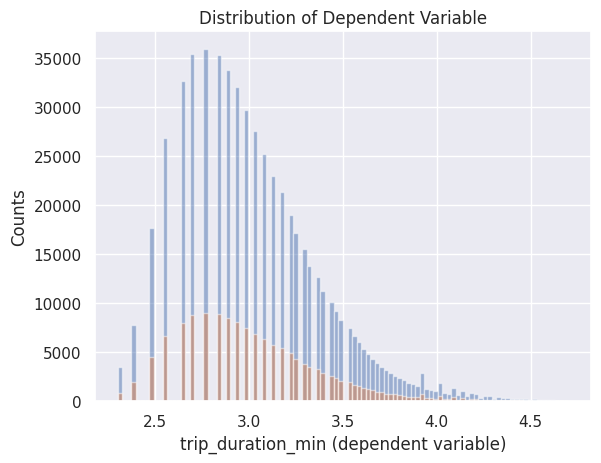

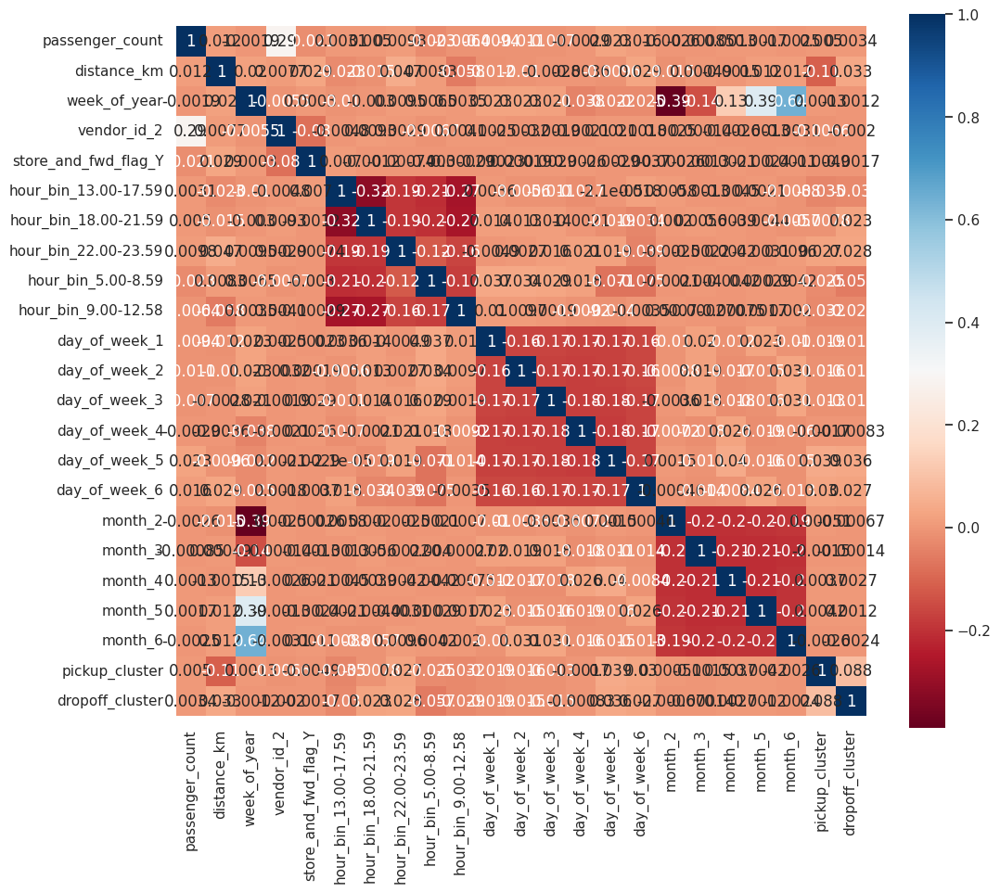

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
plt.hist(y_train_log, bins=100, alpha=0.5, label='Train')  # Set alpha for transparency
plt.hist(y_test_log, bins=100, alpha=0.5, label='Test')
plt.xlabel('trip_duration_min (dependent variable)')
plt.ylabel('Counts')
plt.title('Distribution of Dependent Variable')
plt.show()
display()
# It appears to have a right-skewed distribution, which is common for variables that cannot go below zero but can potentially reach very high values, such as times.

# Create a heatmap
plt.figure(figsize=(12,10))
sns.heatmap(X_train_df_geo.corr(), square = True, annot = True, cmap = 'RdBu')
plt.show()
display()
# the datetime features indicate high correlation with itself.

### 4.1 Coefficient plot

Training Mean Absolute Error 0.18108314567879097
Test Mean Absolute Error     0.1809986653282783


Text(0.5, 1.0, 'Coefficient plot')

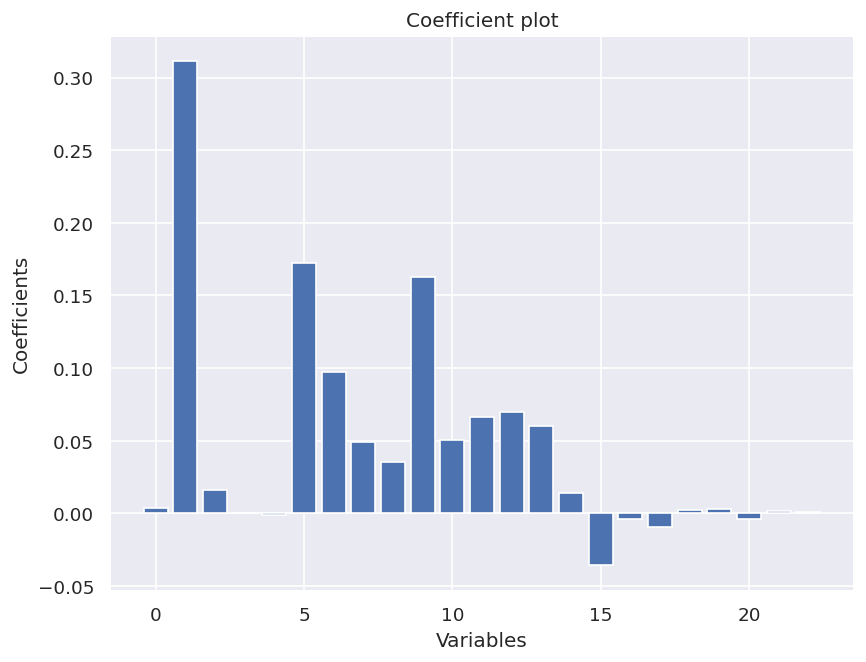

In [ ]:
# Creating instance of Linear Regresssion-------------------------------------------
from sklearn.linear_model import LinearRegression as LR
from sklearn.metrics import mean_absolute_error as mae

lr = LR()
# Fitting the model
lr.fit(X_train_df_geo, y_train_log)

# Predicting over the Train Set and calculating error
train_predict = lr.predict(X_train_df_geo)
k = mae(train_predict, y_train_log)
print('Training Mean Absolute Error', k )

# Predicting over the Test Set and calculating error
test_predict = lr.predict(X_test_df_geo)
k = mae(test_predict, y_test_log)
print('Test Mean Absolute Error    ', k )


# Coefficient plot-----------------------------------------------------
plt.figure(figsize=(8, 6), dpi=120, facecolor='w', edgecolor='b')
x = range(len(X_train_df_geo.columns))
y = lr.coef_
plt.bar( x, y )
plt.xlabel( "Variables")
plt.ylabel('Coefficients')
plt.title('Coefficient plot')
     # seem like the model sorely depends on some variables

### 4.2 Variance_inflation_Factor

In [ ]:
# Check Variance_inflation_Factor ------------------------------------------------------------
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calculating VIF for every column (only works for the not Catagorical)
VIF = pd.Series([variance_inflation_factor(X_train_df_geo.values, i) for i in range(X_train_df_geo.shape[1])], index =X_train_df_geo.columns)
print(VIF)

# Multicollinearity:
    # REMOVE some predictors with inf values ( a clear indication of perfect multicollinearity among predictors)
    # high VIF values includes  month_4-6, week_of_year indicates multicollinearity issues

passenger_count          1.090204
distance_km              1.027470
week_of_year            10.668691
vendor_id_2              2.328004
store_and_fwd_flag_Y     1.012889
hour_bin_13.00-17.59     3.130871
hour_bin_18.00-21.59     3.105086
hour_bin_22.00-23.59     1.902383
hour_bin_5.00-8.59       2.065861
hour_bin_9.00-12.58      2.649693
day_of_week_1            2.020172
day_of_week_2            2.085748
day_of_week_3            2.125575
day_of_week_4            2.213815
day_of_week_5            2.231251
day_of_week_6            2.135430
month_2                  1.949769
month_3                  3.299625
month_4                  5.771225
month_5                  9.343918
month_6                 13.672967
pickup_cluster           3.510489
dropoff_cluster          3.482485
dtype: float64


### 4.3 Residual Plot

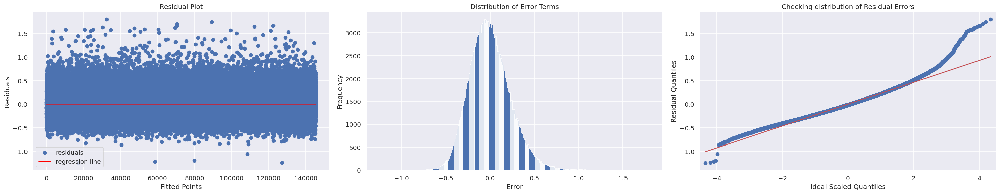

Shapiro-Wilk Test: ShapiroResult(statistic=0.785071074962616, pvalue=0.0)
Durbin-Watson: [0.03170454 0.02066979 2.00141759]


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


In [ ]:
import scipy.stats as stats
from statsmodels.stats.stattools import durbin_watson
import statsmodels.api as sm


# Arranging and calculating the Residuals
residuals = pd.DataFrame({
    'fitted values' : y_test_log,
    'predicted values' : test_predict,
})
residuals['residuals'] = residuals['fitted values'] - residuals['predicted values']


def plot_residual_analysis(residuals):
    # Create a figure with 3 subplots arranged in 3 rows and 1 column
    fig = plt.figure(figsize=(25, 5), dpi=120, facecolor='w', edgecolor='b')

    # Residual Plot
    ax1 = plt.subplot(1,3, 1)
    f = range(0, len(residuals))
    k = [0 for i in range(0, len(residuals))]
    ax1.scatter(f, residuals.residuals, label='residuals')
    ax1.plot(f, k, color='red', label='regression line')
    ax1.set_xlabel('Fitted Points')
    ax1.set_ylabel('Residuals')
    ax1.set_title('Residual Plot')
    ax1.legend()

    # Histogram for distribution of error
    ax2 = plt.subplot(1,3, 2)
    ax2.hist(residuals.residuals, bins=250)
    ax2.set_xlabel('Error')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Distribution of Error Terms')

    # QQ plot
    ax3 = plt.subplot(1,3, 3)
    sm.qqplot(residuals.residuals, line='s', ax=ax3)
    ax3.set_ylabel('Residual Quantiles')
    ax3.set_xlabel('Ideal Scaled Quantiles')
    ax3.set_title('Checking distribution of Residual Errors')

    # Adjust the layout so plots do not overlap
    plt.tight_layout()
    plt.show()

    #  check for the normality of data
    shapiro_test = stats.shapiro(residuals)
    print(f"Shapiro-Wilk Test: {shapiro_test}")

    # detect the presence of autocorrelation (a relationship between values separated from each other
    durbinWatson = durbin_watson(residuals)
    print(f"Durbin-Watson: {durbinWatson}")

plot_residual_analysis(residuals)

* Residual Plot: This pattern suggests that the variance of the residuals is not constant (heteroscedasticity), meaning that the error variance changes
across the range of the fitted values.
* Distribution of Error Terms: The histogram of the residuals is roughly bell-shaped, but not symmetrical and have a peak slightly to the left of zero.
* Q-Q Plot: while the middle quantiles are well aligned with the red line, the tails deviate from normality, indicating that the residuals have heavier tails than the normal distribution.
* Shapiro-Wilk test of normality: p-value is effectively zero, which rejects null hypothesis for this test is that the data is normally distributed.

As the assumptions required for optimal linear regression performance are not fully met, we will condict robust regression methods to improve a resilience for outliers and violations of regression assumptions, including LASSO, Ridge and Elastic Net